# Introduction

In this notebook, we learn how to perform **time series analysis and forecasting**. Time series data measures how a phenomena varies with respect to time, in a time series dataset, time is the **primary structure** used for ordering the measured phenomena. Ideally, the data points are in chronological order with the same interval (hourly, daily, weekly, etc.).
Time series forecasting deals with using past observations of the measured phenomena to predict future trends - it a cross industry research area. Popular use cases for time series forecasting include stock price prediction, product sale volumes, and weather prediction. Time series datasets are time-dependent and show components such as trend and seasonality. As such, data scientists have to use specific **preprocessing and feature engineering techniques** tailored to time series.

# Problem Definition
For this tutorial, We will build time series models to forecast energy demand. We will perform time series analysis to give us a better understanding of the dataset. The objective we are looking to solve:
- What is the future energy-load demand?

This question is useful to energy suppliers who want to minimise waste in their operations. The following process is followed in this notebook:

1. Start with **data description and cleaning**
2. Use **EDA** for better understanding of the dataset
3. **Time series prediction** to forecast energy demand and load.

# Data Collection
The data used in this tutorial is from the 2014 Global Energy Forecasting Competion. We will be using the dataset from Track-L (load). This dataset has 11 years of hourly temperature and 9 years of hourly load.


## Import important libraries

In [ ]:
# warnings for programs
import os
import warnings
from datetime import time
from math import sqrt

# scientific math
import numpy as np
# data processing
import pandas as pd

import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler
# visualisation library
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly
# sklearn

from sklearn.model_selection import train_test_split

%matplotlib inline
# warnings.filterwarnings("ignore")

# ignore filters
warnings.filterwarnings("ignore")


In [ ]:
# Load in the dataset
cwd = os.getcwd()
# dataset path
data_path = cwd + "/data/energy.csv"

# load csv
data = pd.read_csv(data_path)

# show the first 5 observations in the dataset
data.head()

,Date,Hour,load,T
0,1/1/2004,1,NaN,37.33
1,1/1/2004,2,NaN,37.67
2,1/1/2004,3,NaN,37.00
3,1/1/2004,4,NaN,36.33
4,1/1/2004,5,NaN,36.00


Currently, the dataframe has 4 columns -**Date, Hour, load, and temperature (T)**. The dataset is ordered in **hourly-chronological order** and its structure is not yet suited for time series analysis. A time-series dataset has to have a **DateTimeIndex**.

In [ ]:
fig = make_subplots(1,2,
                   subplot_titles=(
                       "Total Energy Load",
                       "Mean Temperature",
                        )
                   )
fig.add_trace(
    go.Scatter(x=data["Date"], y=data["load"],name="load"), row=1, col=1
)
fig.add_trace(
    go.Scatter(x=data["Date"], y=data["T"], name="temperature"), row=1, col=2
)
fig.update_layout(
    width=950,
    height=900
)
fig.show()

# Data processing and cleaning

A good practice is to create a copy of your inital data before you start preprocessing changes.

In [ ]:
data_modified = data.copy()

## Chronological Order and Equidistant Timestamps

Ideally, time series data is in chronological order and the timestamps should be equidistant (constant time intervals). The data seems to be in chronological order but perform the analysis to be sure.

In [ ]:
# check the data types
data_modified.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96432 entries, 0 to 96431
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    96432 non-null  object 
 1   Hour    96432 non-null  int64  
 2   load    78888 non-null  float64
 3   T       96432 non-null  float64
dtypes: float64(2), int64(1), object(1)
memory usage: 2.9+ MB


From the output above, we can see that the following:
- **load** is the only column with missing values.
- **Date** is a string object and not a `datetime64[ns]`

The date column is an object and the hour column is an integer. We will concatenate these two columns into one and convert the combined column to the correct `datetime64[ns]` format. To get the date column in to the correct format  - ***dd/mm/yyyy H:M*** There will be some steps done to get the data to the right format.

We will do this in the next step.

In [ ]:
# create a list from the hour column
hour_list = data_modified["Hour"].tolist()
# create an empty list
hour_list_ = []
# loop through each value in the hour_list
for hours in hour_list:
    # if the value is equal to 24
    if hours == 24:
        # set the number to 0
        hours = 0
    # use the time function to convert the hour value to a time object
    hour_str = time(hour=hours, minute=0).strftime("%H:%M")
    # append the new time value format to the empty list
    hour_list_.append(hour_str)

In [ ]:
# replace values in hour column with hour_list_
data_modified["Hour"] = hour_list_

In [ ]:
# concatenate date and time
data_modified["Date"] = data_modified["Date"] + " " + data_modified["Hour"]

In [ ]:
# convert date column to date time
data_modified["Date"] = pd.to_datetime(data_modified["Date"], format="%d/%m/%Y %H:%M")
# set new index
data_modified = data_modified.set_index(["Date"])


**00:00** should be at the start and not end of the day. Let's fix that

In [ ]:
# sort the dataframe using the DateTimeIndex index
data_modified = (data_modified.
              sort_index()
             )

In [ ]:
data_modified.head()

,Hour,load,T
Date,,,
2004-01-01 00:00:00,00:00,NaN,25.33
2004-01-01 01:00:00,01:00,NaN,37.33
2004-01-01 02:00:00,02:00,NaN,37.67
2004-01-01 03:00:00,03:00,NaN,37.00
2004-01-01 04:00:00,04:00,NaN,36.33


In [ ]:
# check the time intervals
data_modified["time_interval"] = data_modified.index - data_modified.index.shift(1, freq="H")
data_modified["time_interval"].head()

Date
2004-01-01 00:00:00   -1 days +23:00:00
2004-01-01 01:00:00   -1 days +23:00:00
2004-01-01 02:00:00   -1 days +23:00:00
2004-01-01 03:00:00   -1 days +23:00:00
2004-01-01 04:00:00   -1 days +23:00:00
Name: time_interval, dtype: timedelta64[ns]

In [ ]:
print(f"{data_modified['time_interval'].value_counts()}")
data_modified = data_modified.drop("time_interval", axis=1)

-1 days +23:00:00    96432
Name: time_interval, dtype: int64


## Handling Missing Values

There are missing values in the load column. These missing observations have to be handled.

In [ ]:
# check for missing values in the dataset
fig = go.Figure(
    data = go.Bar(
        x= ["Hour","load","T"],
        y=[(num/len(data_modified))*100 for num in list(data_modified.isna().sum())]

    )
)
fig.update_layout(
    plot_bgcolor="white",
    height=450,
    width=450,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Missing values<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="dataset variables",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()


Approximately, 18% of the load column has missing values - since we have a large dataset. we will proceed by removing the observations with missing values.

In [ ]:
# drop missing values
data_clean = (data_modified
       .dropna()
      # .reset_index(drop=True)
       )

# display the first 24 observations
data_clean.head(24)#.style.set_properties(subset=["Date"], **{"background-color":"blue"})

,Hour,load,T
Date,,,
2006-01-01 00:00:00,00:00,2985.0,24.33
2006-01-01 01:00:00,01:00,3010.0,22.67
2006-01-01 02:00:00,02:00,2853.0,20.67
2006-01-01 03:00:00,03:00,2758.0,21.33
2006-01-01 04:00:00,04:00,2705.0,19.00
2006-01-01 05:00:00,05:00,2709.0,19.33
2006-01-01 06:00:00,06:00,2753.0,18.67
2006-01-01 07:00:00,07:00,2849.0,18.00
2006-01-01 08:00:00,08:00,3008.0,17.67


Extract time series features - day, hour, quarter, month, year  - for time series analysis

In [ ]:
# create a copy of df
# data_clean_ = data_clean.copy()
data_clean.head()

,Hour,load,T
Date,,,
2006-01-01 00:00:00,00:00,2985.0,24.33
2006-01-01 01:00:00,01:00,3010.0,22.67
2006-01-01 02:00:00,02:00,2853.0,20.67
2006-01-01 03:00:00,03:00,2758.0,21.33
2006-01-01 04:00:00,04:00,2705.0,19.00


In [ ]:
# extract hour
data_clean['hour'] = data_clean.index.hour
# extract day of the week
data_clean['dayOfWeek'] = data_clean.index.dayofweek
# extract quarter
data_clean['quarter'] = data_clean.index.quarter
# extract the month
data_clean['month'] = data_clean.index.month
# extract the year
data_clean['year'] = data_clean.index.year

In [ ]:
data_clean.head()

,Hour,load,T,hour,dayOfWeek,quarter,month,year
Date,,,,,,,,
2006-01-01 00:00:00,00:00,2985.0,24.33,0,6,1,1,2006
2006-01-01 01:00:00,01:00,3010.0,22.67,1,6,1,1,2006
2006-01-01 02:00:00,02:00,2853.0,20.67,2,6,1,1,2006
2006-01-01 03:00:00,03:00,2758.0,21.33,3,6,1,1,2006
2006-01-01 04:00:00,04:00,2705.0,19.00,4,6,1,1,2006


In [ ]:
# make change to day of week column
# 0 - monday to 1 - monday
# 6 - Sunday to 7 - sunday
data_clean["dayOfWeek"] = data_clean["dayOfWeek"] + 1

In [ ]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(x =data_clean.index,y=data_clean["load"])
)

fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Energy demand plot<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Energy load",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x =data_clean.index,y=data_clean["T"])
)

fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Temperature plot<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Temperature",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

## Resampling
Resampling is a form of date time feature engineering to better understand the time series dataset. There are two kinds of resampling methods:
- **Upsampling** increases the frequency of the samples (e.g weekly to daily)
- **Downsampling** reduces the frequency of the samples (e.g weekly to monthly)

We will increase the frequency of our hourly dataset to daily, weekly, monthly, quarterly, annually for both temperature and load

In [ ]:
# create visualisations for the demand in various timeframes
cols = plotly.colors.DEFAULT_PLOTLY_COLORS
fig = make_subplots(5,2,
                   subplot_titles=(
                       "Daily Total Energy Load",
                       "Daily Mean Temperature",
                       "Weekly Total Energy Load",
                       "Weekly Mean Temperature",
                       "Monthly Total Energy Load",
                       "Monthly Mean Temperature",
                       "Quarterly Total Energy Load",
                       "Quarterly Mean Temperature",
                       "Annual Total Energy Load",
                       "Annual Mean Temperature"
                        )
                   )

# daily
load_daily = data_clean["load"].resample("D").sum()
fig.add_trace(
    go.Scatter(x = load_daily.index, y=load_daily.values,name=" daily load",line=dict(width=2, color=cols[0])), row=1,col=1
)
# weekly
load_weekly = data_clean["load"].resample("7D").sum()
fig.add_trace(
    go.Scatter(x=load_weekly.index, y=load_weekly.values, name="weekly load",line=dict(width=2, color=cols[0])), row=2,col=1
)
# monthly
load_monthly = data_clean["load"].resample("M").sum()
fig.add_trace(
    go.Scatter(x=load_monthly.index, y=load_monthly.values, name="monthly load",line=dict(width=2, color=cols[0])), row=3,col=1
)
# quarterly
load_quarterly = data_clean["load"].resample("Q").sum()
fig.add_trace(
    go.Scatter(x=load_quarterly.index, y=load_quarterly.values, name="quarterly load",line=dict(width=2, color=cols[0])), row=4, col=1
)
# annually
load_annually = data_clean["load"].resample("365D").sum()

fig.add_trace(
    go.Scatter(x = load_annually.index, y=load_annually.values,name=" annual load",line=dict(width=2, color=cols[0])), row=5,col=1
)
##===========Temp
#==============
# daily
temp_daily = data_clean["T"].resample("D").mean()
fig.add_trace(
    go.Scatter(x = temp_daily.index, y=temp_daily.values,name=" daily load",line=dict(width=2, color=cols[0])), row=1,col=2
)
# weekly
temp_weekly = data_clean["T"].resample("7D").mean()
fig.add_trace(
    go.Scatter(x=temp_weekly.index, y=temp_weekly.values, name="weekly load",line=dict(width=2, color=cols[0])), row=2,col=2
)
# monthly
temp_monthly = data_clean["T"].resample("M").mean()
fig.add_trace(
    go.Scatter(x=temp_monthly.index, y=temp_monthly.values, name="monthly load",line=dict(width=2, color=cols[0])), row=3,col=2
)
# quarterly
temp_quarterly = data_clean["T"].resample("Q").mean()
fig.add_trace(
    go.Scatter(x=temp_quarterly.index, y=temp_quarterly.values, name="quarterly load",line=dict(width=2, color=cols[0])), row=4, col=2
)
# annually
temp_annually = data_clean["T"].resample("365D").mean()

fig.add_trace(
    go.Scatter(x = temp_annually.index, y=temp_annually.values,name=" annual load",line=dict(width=2, color=cols[0])), row=5,col=2
)
# fig.add_trace(
#     go.Scatter(x = data_clean.index, y=data_clean["T"], name="hourly temperature"), row=2, col=1
# )

fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Energy load and temperature<br>for different time frames<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

## Stationarity

**Stationarity** is an important property of time series data as some statiscal models assume that the input time series is stationary. A stationary time series is one where the **statistical parameters** are constant with respect to time. **A time series with trends, or seasonality, are not stationarity**.

However, a time series with cyclic properties is stationary. The cycles are not of fixed length, therefore we can't predict where the peaks and troughs of the cycles will be.

### Stationary series
A stationary time series has no predictable patterns in the long term - in a time plot the series should be roughly horizontal, with constant variance.  A stationary time series has the following properties with respect time:
- constant mean
- constant variance
- constant covariance


In [ ]:
np.random.seed(0)
# independent
x = np.arange(20)
# dependent
mean = 5
sd = 2
y = []
y.append(mean)
for i in x[1:]:
  if i%2 == 0:
    y.append(mean+sd)
  else:
    y.append(mean-sd)

In [ ]:
np.mean(y)

4.9

In [ ]:
# create visualisations for the demand in various timeframes
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = x, y=y,name="stationary-series")#, mode='markers')
)
fig.add_trace(
    go.Scatter(x = x, y=[max(y)]*len(x),line = dict(color='grey', width=1, dash='dash'))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x = x, y=[np.mean(y)]*len(x),line = dict(color='grey', width=1))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x = x, y=[min(y)]*len(x),line = dict(color='grey', width=1, dash='dash'))#, mode='markers')
)
fig.update_yaxes(
    range=[0,11]
)
fig.update_layout(
    plot_bgcolor="white",
    height=450,
    width=450,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Stationary series<br>Constant mean<br>Constant variance",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

### Non-Stationary Series

Let us now create non-stationary series:
#### Time-dependent Variance
- time-dependent variance both the **arithmetic or geometric series** fits this criteria
  - constant mean
  - non-constant variance
  - constant covariance


In [ ]:
# independent
x = np.arange(20)
# dependent
mean = 5
sd = 2
y = []
y.append(mean)
for i in x[1:]:
  if i%2 == 0:
    adjustment = 1- (i/(len(x)))
    y.append(mean+(adjustment*sd))
  else:
    adjustment = 1 - (i/(len(x)))
    y.append(mean-(adjustment*sd))

In [ ]:
y_centre = [mean]* len(x)
y_1 = [-((sd/len(x))*i) + mean+sd for i in x]
y_2 = [((sd/len(x))*i) + mean-sd for i in x]

In [ ]:
fig = go.Figure()
# non-stationary series
fig.add_trace(
    go.Scatter(x =x, y=y,name="time-dependent series")#, mode='markers')
)
# mean line
fig.add_trace(
    go.Scatter(x=x, y=y_centre,line = dict(color='grey', width=1))#, mode='markers')
)
# y 1
fig.add_trace(
    go.Scatter(x=x, y=y_1,line = dict(color='grey', width=1, dash="dash"))#, mode='markers')
)
# y 2
fig.add_trace(
    go.Scatter(x=x, y=y_2,line = dict(color='grey', width=1,dash="dash"))#, mode='markers')
)
fig.update_layout(
    plot_bgcolor="white",
    height=450,
    width=450,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Non-stationary series<br>Constant mean<br>Non-constant variance",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

#### Time-dependent Mean
- time-dependent mean:
  - non-constant mean
  - constant variance
  - constant covariance

In [ ]:
x = np.arange(20)
# dependent
mean = 5
sd = 5
y = []
y.append(mean)
for i in x[1:]:
  if i%2 == 0:
    adjustment = mean * i
    y.append(adjustment + sd)
  else:
    adjustment = mean * i
    y.append(adjustment - sd)

In [ ]:
y_center = [mean*i for i in x]
y_1 = [(mean*i )+ sd for i in x ]
y_2 = [(mean*i )- sd for i in x ]

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x =x, y=y,name="time-dependent series")#, mode='markers')
)
fig.add_trace(
    go.Scatter(x =x, y=y_center,line = dict(color='grey', width=1))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x =x, y=y_1,line = dict(color='grey', width=1, dash="dash"))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x =x, y=y_2,line = dict(color='grey', width=1, dash="dash"))#, mode='markers')
)

fig.update_layout(
    plot_bgcolor="white",
    height=450,
    width=450,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Non-stationary series<br>Non-constant mean<br>Constant variance",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

#### Time-dependent covariance
- time-dependent covariance:
  - constant mean
  - constant variance
  - non-constant covariance

In [ ]:
# independent
x = np.arange(20)
temp =np.arange(20)
temp[2:4] = 2
x_variance = temp
# dependent
mean = 5
sd = 2
y = []
y.append(mean)
for i in x[1:]:
  if i%2 == 0:
    y.append(mean+sd)
  else:
    y.append(mean-sd)

In [ ]:
# create visualisations for the demand in various timeframes
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = x_variance, y=y,name="stationary-series")#, mode='markers')
)
fig.add_trace(
    go.Scatter(x = x, y=[max(y)]*len(x),line = dict(color='grey', width=1, dash='dash'))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x = x, y=[np.mean(y)]*len(x),line = dict(color='grey', width=1))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x = x, y=[min(y)]*len(x),line = dict(color='grey', width=1, dash='dash'))#, mode='markers')
)
fig.update_yaxes(
    range=[0,11]
)
fig.update_layout(
    plot_bgcolor="white",
    height=450,
    width=450,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Stationary series<br>Constant mean<br>Non-constant covariance",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

Stationarity check can be done with the following methods:
1. **visual**: plot series and look for trends or seasonal changes
2. **parameter checks**: divide series and analyse stastical change in each division
3. **statistical test**: Perform Augemented Dickey Fuller test

In [ ]:
# define rolling window - 365 days ~ a year
rolling_window = 365

# load rolling mean
load_rolling_mean = load_daily.rolling(rolling_window).mean()
# load rolling std
load_rolling_std = load_daily.rolling(rolling_window).std()

# temperature rolling mean
temp_rolling_mean = temp_daily.rolling(rolling_window).mean()
# temperature rolling std
temp_rolling_std = temp_daily.rolling(rolling_window).std()

In [ ]:
load_rolling_mean.index

DatetimeIndex(['2006-01-01', '2006-01-02', '2006-01-03', '2006-01-04',
               '2006-01-05', '2006-01-06', '2006-01-07', '2006-01-08',
               '2006-01-09', '2006-01-10',
               ...
               '2014-12-22', '2014-12-23', '2014-12-24', '2014-12-25',
               '2014-12-26', '2014-12-27', '2014-12-28', '2014-12-29',
               '2014-12-30', '2014-12-31'],
              dtype='datetime64[ns]', name='Date', length=3287, freq='D')

In [ ]:
# create visualisations for the demand in various timeframes
fig = go.Figure()
fig.add_trace(
    go.Scatter(x=load_daily.index, y=load_daily.values,name="load-daily")#, mode='markers')
)
fig.add_trace(
    go.Scatter(x=load_rolling_mean.index, y=load_rolling_mean.values,name="rolling mean",line = dict(color='black', width=2))#, dash='dash'))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x=load_rolling_std.index, y=load_rolling_std.values,name="rolling std",line = dict(color='red', width=2))#, mode='markers')
)
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Energy load</b>: Non-stationary<br>non-constant mean and variannce mean<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Energy load",
    showlegend=True
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
# create visualisations for the demand in various timeframes
fig = go.Figure()
fig.add_trace(
    go.Scatter(x=temp_daily.index, y=temp_daily.values,name="temperature-daily")#, mode='markers')
)
fig.add_trace(
    go.Scatter(x=temp_rolling_mean.index, y=temp_rolling_mean.values,name="rolling mean",line = dict(color='black', width=2))#, dash='dash'))#, mode='markers')
)
fig.add_trace(
    go.Scatter(x=temp_rolling_std.index, y=temp_rolling_std.values,name="rolling std",line = dict(color='red', width=2))#, mode='markers')
)
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Temperature</b>: Non-staionary<br>non-constant variance (seasonality)",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Temperature",
    showlegend=True
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

Basic statistical parameter check steps:
- split each series into `x` partitions
- check the mean and variance of each partition

In [ ]:
# resample load to daily sum
stationary_df = data_clean[["load"]].resample("D").sum()
# resample temperature to daily mean
stationary_df["temperature"] = data_clean[["T"]].resample("D").mean()


In [ ]:
split = 2
split_length = int(len(stationary_df)/split)
# get mean and variance for each split
split1_mean = stationary_df.head(split_length).mean()
split1_var = stationary_df.head(split_length).var()
split2_mean = stationary_df.tail(split_length).mean()
split2_var = stationary_df.tail(split_length).var()

In [ ]:
stationary_pd = pd.concat([split1_mean, split2_mean, split1_var, split2_var],axis=1)
stationary_pd.columns=["split 1 mean", "split 2 mean", "split 1 var", "split 2 var"]

In [ ]:
stationary_pd

,split 1 mean,split 2 mean,split 1 var,split 2 var
load,79452.913877,79332.478089,5.117831e+07,5.369970e+07
temperature,46.727024,48.410144,3.222605e+02,3.401956e+02


# Exploratory Data Analysis and Time Series Analysis

The following are some of the goals of exploratory data analysis:
1. What is the character of these time series?
2. Does the time series have any regular patterns in time, i.e. seasonal cycles or trend?
3. What are the anomalies and how are they identified?
4. Do the variables have any associations that could be studied further?
5. How much data is required?

### Time series distribution
The distribution of a stationary time series will be a Gaussian. Let us now plot the distribution of the daily series for temperature and energy load.


In [ ]:
# use the square-root rule to determine the number of bins
num_samples = len(data_clean.index)
num_bins = int(sqrt(num_samples))
num_bins

280

In [ ]:
# lets look at the distribution
# data_clean["load"].plot.hist(edgecolor = 'black')#bins=num_bins,  edgecolor = 'black')
# create visualisations for the demand in various timeframes
fig = go.Figure()
fig.add_trace(
    go.Histogram(x=data_clean["load"].resample("D").sum())#, mode='markers')
)
# fig.add_trace(
#     go.Scatter(x=temp_rolling_mean.index, y=temp_rolling_mean.values,name="rolling mean",line = dict(color='black', width=2))#, dash='dash'))#, mode='markers')
# )
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Energy load</b>: Non-staionary<br>non-constant variance (seasonality)",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Load",
    yaxis_title="Load count",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
# data_clean["T"].plot.hist(  edgecolor = 'black')
fig = go.Figure()
fig.add_trace(
    go.Histogram(x=data_clean["T"].resample("D").mean())#, mode='markers')
)
# fig.add_trace(
#     go.Scatter(x=temp_rolling_mean.index, y=temp_rolling_mean.values,name="rolling mean",line = dict(color='black', width=2))#, dash='dash'))#, mode='markers')
# )
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Temperature</b>: Non-staionary<br>non-constant variance (seasonality)",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Load",
    yaxis_title="Load count",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
# create visualisations for the demand in various timeframes
fig = make_subplots(5,1,
                    subplot_titles=(
                        "Energy load distribution by hour",
                        "Energy load distribution by day of week",
                        "Energy load distribution by month",
                        "Energy load distribution by quarter",
                        "Energy load distribution by year"
                    ))

fig.add_trace(
    go.Box(x = data_clean['hour'], y=data_clean['load'],name="hour")
)
fig.add_trace(
    go.Box(x = data_clean['dayOfWeek'], y=data_clean['load'], name="dayofWeek"), row=2, col=1
)
fig.add_trace(
    go.Box(x = data_clean['month'], y=data_clean['load'], name="month"), row=3, col=1
)
fig.add_trace(
    go.Box(x = data_clean['quarter'], y=data_clean['load'], name="quarter"), row=4, col=1
)
fig.add_trace(
    go.Box(x = data_clean['year'], y=data_clean['load'], name="year"), row=5, col=1
)
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Energy distribution<br>per various time frames<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
# create visualisations for the demand in various timeframes
fig = make_subplots(5,1,
                    subplot_titles=(
                        "Temperature distribution by hour",
                        "Temperature distribution by day of week",
                        "Temperature distribution by month",
                        "Temperature distribution by quarter",
                        "Temperature distribution by year"
                    ))

fig.add_trace(
    go.Box(x = data_clean['hour'], y=data_clean['T'], name="hour")
)
fig.add_trace(
    go.Box(x = data_clean['dayOfWeek'], y=data_clean['T'], name="dayofWeek"), row=2, col=1
)
fig.add_trace(
    go.Box(x = data_clean['month'], y=data_clean['T'], name="month"), row=3, col=1
)
fig.add_trace(
    go.Box(x = data_clean['quarter'], y=data_clean['T'], name="quarter"), row=4, col=1
)
fig.add_trace(
    go.Box(x = data_clean['year'], y=data_clean['T'], name="year"), row=5, col=1
)
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="Temperature distribution<br>per various time frames<br>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

Visualise the relationship between temperature and energy load. Temperature will be the independent variable and energy load is the dependent variable.

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x =data_clean["T"],y=data_clean["load"] ,mode='markers')
)

fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Temperature</b> vs <b>Energy load</b>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Temperature",
    yaxis_title="Energy load",
    showlegend=False
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

From the figure above, we can see that load and temperature have a **non-linear** relationship.

## Time Series Decomposition
Let us look at the following time-related information and features:
- Trend : investigate if their is any visible change in load and temperatures - such as increase or decrease in value over a prolonged period of time.
- Seasonality : investigate any recurring and persistent patterns within a time period
- Cyclic: investigate any recurring and persistent patterns of upward or downward changes - no fixed pattern
- Noise: investigate any irregular and unpredictable changes in the the data

The `statsmodels` module has the `seasonal_decompose()` function which allows us to **decompose** the time series data into the four components mentioned above.

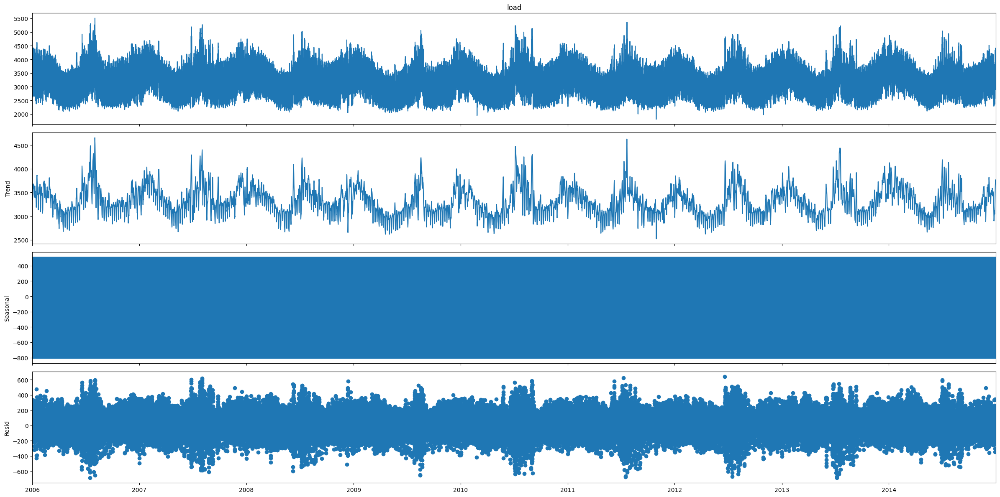

In [ ]:
# extract the load
load_decomposition = sm.tsa.seasonal_decompose(data_clean["load"])
# create figure
fig_load = load_decomposition.plot()
matplotlib.rcParams['figure.figsize'] = [24, 10]

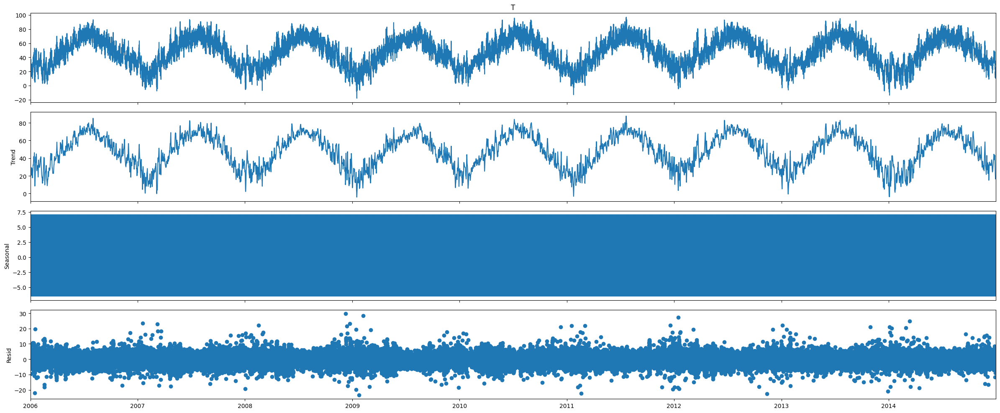

In [ ]:
# extract the temperature
temp_decomposition = sm.tsa.seasonal_decompose(data_clean["T"])
# create figure
fig_temp = temp_decomposition.plot()
matplotlib.rcParams['figure.figsize'] = [24, 10]

From the two seasonal figures above, we can see there is not much information to be gleaned from the plot. Therefore, we will resample the data from an hourly scale to a daily scale.

Before resampling the dataset, we need to seperate the load and temperature columns. This is because for the load column - we would want the daily load, this equates to calculating the **sum** for each day. While for the temperature, we would get more information by calculating the **mean** temperature for the day.

In [ ]:
# seperate the load and temperature to their own dataframes
load_df = pd.DataFrame(data_clean["load"])
temp_df = pd.DataFrame(data_clean["T"])

In [ ]:
len(load_df)

78888

In [ ]:
# resample the load to daily sum
load_df_daily = load_df.resample("D").sum()
# resample the temperature df to daily mean
temp_df_daily = temp_df.resample("D").mean()

In [ ]:
len(load_df_daily)

3287

In [ ]:
load_df_daily

,load
Date,
2006-01-01,80938.0
2006-01-02,81801.0
2006-01-03,86932.0
2006-01-04,87957.0
2006-01-05,87088.0
...,...
2014-12-27,73845.0
2014-12-28,74678.0
2014-12-29,84486.0


Now, let us decompose these daily time series.

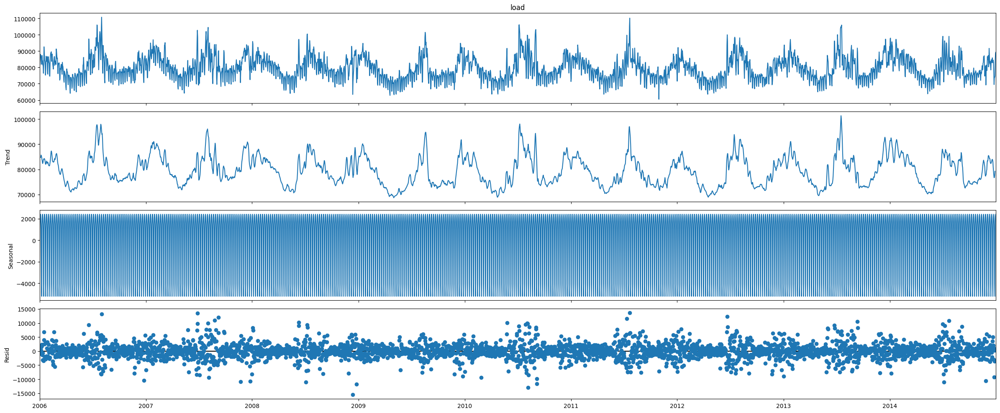

In [ ]:
# extract the load
load_decomposition = sm.tsa.seasonal_decompose(load_df_daily["load"])
# create figure
fig_load = load_decomposition.plot()
matplotlib.rcParams['figure.figsize'] = [24, 12]

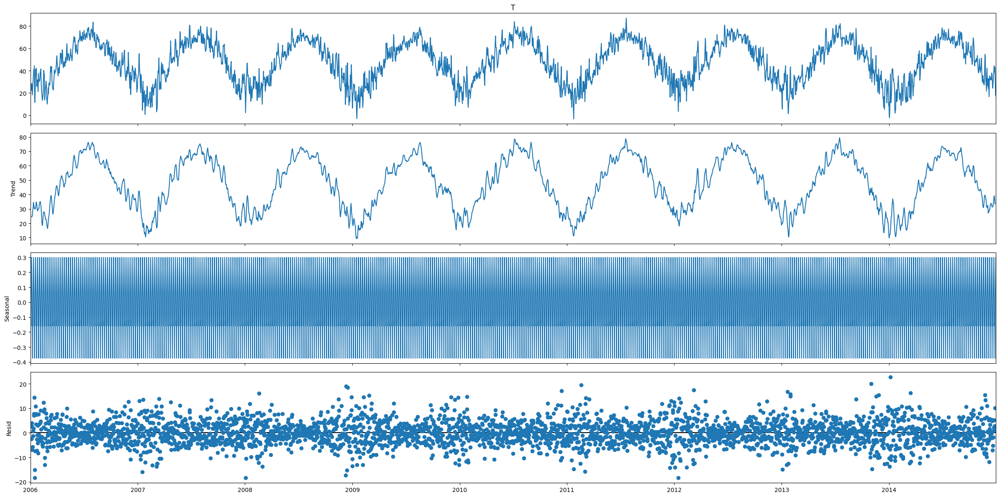

In [ ]:
# extract the temperature
temp_decomposition = sm.tsa.seasonal_decompose(temp_df_daily["T"])
# create figure
fig_temp = temp_decomposition.plot()
matplotlib.rcParams['figure.figsize'] = [24, 12]

# Time Series Forecasting

The following methods are simplistic and quite effective forecsting methods that are typically used as benchmarks.

- average method
- naive method
- seasonal naive method
- drift method

### Data Splitting
In order to validate the performance of each method we will split the dataset into train/validation/test with the following ratio:

- train: 70%
- validation: 20%
- test: 10%

In [ ]:
# calculate train_test_indice
# train_test because train (includ. val)
train_test_indice = int(len(load_df_daily) * 0.9)
# train_test_indice
# create extract datetimeIndex based on indice
train_indice = load_df_daily.index[train_test_indice]
# train_indice

In [ ]:
# test_indice

In [ ]:
# create train and test df using indice
# dataframe that contains train and validation - will be split next
load_train_val_df = load_df_daily.loc[:train_indice]
temp_train_val_df = temp_df_daily.loc[:train_indice]
# dataframe that contains test
# shift the train_indice timestamp by one day - so test does not contain last value of validation set
test_indice = train_indice + pd.Timedelta(hours=24)
# use test_indice to split daily
load_test_df = load_df_daily.loc[test_indice:]
temp_test_df = temp_df_daily.loc[test_indice:]

In [ ]:
# now split the train_val dataset into train and validation
train_val_indice = int(len(load_train_val_df) *0.8)
# train_val_indice
# create extract datetimeIndex based on train_val_indice
val_indice = load_train_val_df.index[train_val_indice]

In [ ]:
load_train_df = load_train_val_df.loc[:val_indice]
temp_train_df = temp_train_val_df.loc[:val_indice]
# validation indice
val_start_indice = val_indice + pd.Timedelta(hours=24)
# split validation set
load_val_df = load_train_val_df.loc[val_start_indice:]
temp_val_df = temp_train_val_df.loc[val_start_indice:]

In [ ]:
load_train_df.head(),load_train_df.tail()

(               load
 Date               
 2006-01-01  80938.0
 2006-01-02  81801.0
 2006-01-03  86932.0
 2006-01-04  87957.0
 2006-01-05  87088.0,
                load
 Date               
 2012-06-21  99963.0
 2012-06-22  95986.0
 2012-06-23  80384.0
 2012-06-24  75085.0
 2012-06-25  80359.0)

In [ ]:
load_val_df.head(),load_val_df.tail()

(               load
 Date               
 2012-06-26  77557.0
 2012-06-27  76971.0
 2012-06-28  81984.0
 2012-06-29  85937.0
 2012-06-30  82980.0,
                load
 Date               
 2014-02-02  77887.0
 2014-02-03  84638.0
 2014-02-04  86601.0
 2014-02-05  88175.0
 2014-02-06  87749.0)

In [ ]:
load_test_df.head(), load_test_df.tail()

(               load
 Date               
 2014-02-07  88645.0
 2014-02-08  83729.0
 2014-02-09  81438.0
 2014-02-10  87235.0
 2014-02-11  90277.0,
                load
 Date               
 2014-12-27  73845.0
 2014-12-28  74678.0
 2014-12-29  84486.0
 2014-12-30  88810.0
 2014-12-31  89246.0)

Plot the train, validation, and test set

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = load_train_df.index, y=load_train_df["load"],name="train")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_val_df["load"], name="validation")
)

fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Daily Energy Load</b></b>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Daily Energy load",
    showlegend=True
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = temp_train_df.index, y=temp_train_df["T"],name="train")
)
fig.add_trace(
    go.Scatter(x = temp_val_df.index, y=temp_val_df["T"], name="validation")
)

fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Daily Temperature</b></b>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Daily Temperature",
    showlegend=True
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = load_train_df.index, y=load_train_df["load"],name="train")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_val_df["load"], name="validation")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_avg, name="average_forecast")
)
fig.update_layout(height=900, width=950, title_text="Daily total energy load")
fig.show()

In [ ]:
def forecast_plots(method, y_forecast, variable="load", title = "Forecast energy load"):


  fig = go.Figure()

  if variable == "load":
      global load_train_df
      train_data = load_train_df
      global load_val_df
      val_data = load_val_df
  elif variable == "T":
      global temp_train_df
      train_data = temp_train_df
      global temp_val_df
      val_data = temp_val_df
  else:
      print("Invalid keyword")

  fig = go.Figure()

  fig.add_trace(
      go.Scatter(x = train_data.index, y=train_data[variable],name="train "+variable)
  )
  fig.add_trace(
      go.Scatter(x = val_data.index, y=val_data[variable], name="validation "+variable)
  )
  fig.add_trace(
      go.Scatter(x = val_data.index, y=y_forecast, name=method+"_forecast")
  )
  if variable=="load":
      y_axis = "Energy load (W)"
  elif variable=="T":
      y_axis ="Temperature (C)"

  fig.update_layout(
  plot_bgcolor="white",
  height=900,
  width=950,
  margin={
      "l":25,
      "r":25,
      "b":25
  },
  title_text=title,
  title={
      "x":0.5,
      "xanchor":"center",
      "font":{
          "size":14
      }
  },
  xaxis_title="Time",
  yaxis_title=y_axis,
  showlegend=True
)
  fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
  fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
  fig.show()


### Average Method

In this method, the forecasts of all future values are the average of the historical data.

let:

$y_{1},...,y_{T}$: historical data

$\hat y_{T+h|T} = \bar y = (y_{1}+...+y_{T})/T $

$\hat y_{T+h|T}$ - estimate of $y_{T+h|T}$ is based on the historical data.

In [ ]:
# calculate averages of training data
# replicate the mean by the number of observations in the validation set
load_avg = list(load_train_df.mean().values) * len(load_val_df)

In [ ]:
temp_avg = list(temp_train_df.mean().values) * len(temp_val_df)

In [ ]:
forecast_plots("Average",load_avg, "load", "Average Forecast method - load")

In [ ]:
forecast_plots("Average",temp_avg, "T", "Average Forecast method - temperature")

### Naive Method

In this method, we set all the forecasts to be the value of the last observation.

$$\hat y_{T+h|T} = y_{T}$$

This method is best suited for economic and financial time series.

In [ ]:
# get the last observation of the load and temp series
load_naive = load_train_df.values.tolist()[-1] * len(load_val_df)


In [ ]:
len(load_naive)

591

In [ ]:
temp_naive = temp_train_df.values.tolist()[-1] * len(temp_val_df)

In [ ]:
forecast_plots("Naive",load_naive, "load", "Naive Forecast method - load")

In [ ]:
# plot
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = load_train_df.index, y=load_train_df["load"],name="train")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_val_df["load"], name="validation")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_naive, name="naive_forecast")
)
fig.update_layout(height=900, width=950, title_text="Naive forecast - total energy load")
fig.show()

In [ ]:
forecast_plots("Naive",temp_naive, "T", "Naive Forecast method - temperature")

### Seasonal Naive Method

This method is used for highly seasonal data. In this method, each forecast is equal to the last observed value form the same season, for example the same day a year ago. The forecast is written as

$$\hat y_{T+h|T} = y_{T+h-m(k+1)} $$

where:
- m: seasonal period
- k: number of complete years in the forecast period prior to the future time



In [ ]:
load_train_df.head()


,load
Date,
2006-01-01,80938.0
2006-01-02,81801.0
2006-01-03,86932.0
2006-01-04,87957.0
2006-01-05,87088.0


In [ ]:
load_train_df.tail()

,load
Date,
2012-06-21,99963.0
2012-06-22,95986.0
2012-06-23,80384.0
2012-06-24,75085.0
2012-06-25,80359.0


In [ ]:
years = 6

In [ ]:
def seasonal_forecast(years,df_train, df_val):
    # create seasonal prediction list
    seasonal_prediction = []
    # iterate through each value in the validation
    for day in df_val.index.tolist():
        # create list to store seasonal past observations
        past_days_obs = []
        # iterate through the number of years in the train
        for year in range(1, years+1):
            # get the timedelta
            time_change = pd.DateOffset(years=year)
            try:
                # calculate previous day
                previous_day = day - time_change
            except Exception as e:
                continue

            if previous_day in df_train.index:
                # add to past observation list
                past_days_obs.append(df_train.loc[previous_day].values)
            else:
                continue
        y_seasonal = np.mean(past_days_obs)
        seasonal_prediction.append(y_seasonal)

    return seasonal_prediction


In [ ]:
# seasonal_prediction = []
# for day in load_val_df.index.tolist():
# #     print("#"*20)
# #     print(f"validation day-- {day}")
# #     print("#"*20)
#     past_days_obs = []
#     for year in range(1, years+1):
#         time_change = pd.DateOffset(years= year) #pd.Timedelta(days=year*365)
#         try:

#             previous_day = day - time_change
#             print(previous_day)

# #             print(load_train_df.loc[previous_day])
#         except Exception as e:
#             print(f"{e} - cant get previous day")
#         # check if day is in training
#         if previous_day in load_train_df.index:
#             # add to list
#             past_days_obs.append(load_train_df.loc[previous_day].values)
#         else:
#             continue
#     y_seasonal = np.mean(past_days_obs)
#     seasonal_prediction.append(y_seasonal)



In [ ]:
load_seasonal = seasonal_forecast(6, load_train_df, load_val_df)
len(load_seasonal)

591

In [ ]:
forecast_plots("Seasonal",load_seasonal, "load", "Seasonal Naive Forecast method - load")

In [ ]:
temp_seasonal = seasonal_forecast(6, temp_train_df, temp_val_df)
print(len(temp_seasonal))

591


In [ ]:
forecast_plots("Seasonal",temp_seasonal, "T", "Seasonal Naive Forecast method - temperature")

### Drift Method

This a variation of the naive method - were the forecasts are allowed to increase or decrease over time. The amount of change over time is reffered to as **drift**, which is the average change seen in the past. The forecast for a specified horizon - $T + h$:

$$\hat y_{T+h|h}  = y_{T} + \frac{h}{T - 1}\sum_{t=2}^{T} (y_{t} - y_{t-1}) = y_{T} + h (\frac{y_{T} - y_{1}}{T - 1})$$

Where:

$y_{T}$ - Last observation

$y_1$ - First observation

h - horizon

In [ ]:
# calculate drift method
# changing values
# time period - increase with the length of validation data
# number of past time periods is the length of training set
# # constants
# last value in training  - yt
# first value in training - y1
# for num in range(1, 20+1):
#     print(num)
# load
# get first observation
load_first = load_train_df.iloc[0].load
# get last observation
load_last = load_train_df.iloc[-1].load
# get load forecast horizon
load_horizon = len(load_val_df)
# get the number of previous observations
load_obs = len(load_train_df)

# temp
# get first observation
temp_first = temp_train_df.iloc[0].values[0]
# get last observation
temp_last = temp_train_df.iloc[-1].values[0]
# get temp forecast horizon
temp_horizon = len(temp_val_df)
# get number of previous observations
temp_obs = len(temp_train_df)

In [ ]:
temp_last#.values[0]

64.44416666666667

In [ ]:
def drift_forecast(forecast_horizon, last_obs, first_obs, numb_obs):
    forecast_list = []
    for h in range(1, forecast_horizon+1):
        y_hat = last_obs + (h*(last_obs-first_obs)/(numb_obs - 1))
        forecast_list.append(y_hat)

    return forecast_list


In [ ]:
# drift forecasts
load_drift = drift_forecast(load_horizon, load_last, load_first, load_obs)
temp_drift = drift_forecast(temp_horizon, temp_last, temp_first, temp_obs)

In [ ]:
forecast_plots("Drift",load_drift, "load", "Drift Forecast method - load")

In [ ]:
forecast_plots("Drift",temp_drift, "T", "Drift Forecast method - temp")

## Forecast Accuracy Evaluation

The forecast 'error' is simply the difference between an observed value and its forecast. The error is the unpredictable portion of the observation and is written as:
$$e_{T+h} = y_{T+h} - \hat y_{T=h|T}$$

where:

Training data is  $\{y_{1},...,y_{T}\}$

Test data is $\{y_{T+1},y_{T+2},...\}$

The two error measures that will be used in this notbook are the MAE and RMSE.

**Mean absolute error:** is a measure of errors between paired observations expressing the same phenomenon. This error measure is commonly used measure forecast error in time series analysis. It is simply the average absolute verticcal or horiontal distance between each point in a scatter plot and the Y=X line.

$$ MAE = mean(|e_{t}|)$$

**Root mean squared error:** is the standard deviation of the residuals. THe residuals measure how far from the regression line data poins are. RMSE simply measures the spread of the reiduals essentially informing you of the concetration of data around the line of best fit.

$$RMSE = \sqrt(mean(\mathrm{e}^{2}_{t})$$

In [ ]:
from sklearn.metrics import mean_absolute_error as MAE
from sklearn.metrics import mean_squared_error as MSE
from math import sqrt

def RMSE(mse):
    return sqrt(mse)

In [ ]:
# calculate errors for mean
# mean method
load_avg_mae = MAE(load_val_df["load"], load_avg)
load_avg_rmse = RMSE(MSE(load_val_df["load"], load_avg))
# naive method
load_naive_mae = MAE(load_val_df["load"], load_naive)
load_naive_rmse = RMSE(MSE(load_val_df["load"], load_naive))
#seasonal method
load_seasonal_mae = MAE(load_val_df["load"], load_seasonal)
load_seasonal_rmse = RMSE(MSE(load_val_df["load"], load_seasonal))
# drift method
load_drift_mae = MAE(load_val_df["load"], load_drift)
load_drift_rmse = RMSE(MSE(load_val_df["load"], load_drift))

In [ ]:
load_error_dict = {}
# methods
load_error_dict["methods"] = ["Mean", "Naive", "Seasonal Naive", "Drift"]
load_error_dict["MAE"] = [load_avg_mae, load_naive_mae, load_seasonal_mae, load_drift_mae]
load_error_dict["RMSE"] = [load_avg_rmse, load_naive_rmse, load_seasonal_rmse, load_drift_rmse]
load_error_dict

{'methods': ['Mean', 'Naive', 'Seasonal Naive', 'Drift'],
 'MAE': [6136.60668615951,
  6122.334179357022,
  4467.480795262267,
  6120.9172473026965],
 'RMSE': [7647.158673672504,
  7545.728677618003,
  5851.923820610397,
  7549.86896248381]}

In [ ]:
temp_val_df["T"]

Date
2012-06-26    61.070000
2012-06-27    64.180417
2012-06-28    70.264583
2012-06-29    72.125000
2012-06-30    77.360833
                ...    
2014-02-02    35.444167
2014-02-03    27.471667
2014-02-04    22.778333
2014-02-05    21.236250
2014-02-06    13.917083
Freq: D, Name: T, Length: 591, dtype: float64

In [ ]:
# mean method
temp_avg_mae = MAE(temp_val_df["T"], temp_avg)
temp_avg_rmse = RMSE(MSE(temp_val_df["T"], temp_avg))
# naive method
temp_naive_mae = MAE(temp_val_df["T"], temp_naive)
temp_naive_rmse = RMSE(MSE(temp_val_df["T"], temp_naive))
#seasonal method
temp_seasonal_mae = MAE(temp_val_df["T"], temp_seasonal)
temp_seasonal_rmse = RMSE(MSE(temp_val_df["T"], temp_seasonal))
# drift method
temp_drift_mae = MAE(temp_val_df["T"], temp_drift)
temp_drift_rmse = RMSE(MSE(temp_val_df["T"], temp_drift))

In [ ]:
temp_error_dict = {}
# methods
temp_error_dict["methods"] = ["Mean", "Naive", "Seasonal Naive", "Drift"]
temp_error_dict["MAE"] = [temp_avg_mae, temp_naive_mae, temp_seasonal_mae, temp_drift_mae]
temp_error_dict["RMSE"] = [temp_avg_rmse, temp_naive_rmse, temp_seasonal_rmse, temp_drift_rmse]
temp_error_dict

{'methods': ['Mean', 'Naive', 'Seasonal Naive', 'Drift'],
 'MAE': [16.774913760425243,
  20.070852368866333,
  6.193286073510058,
  23.937166280231267],
 'RMSE': [19.314274682911822,
  25.444145772132845,
  7.911492263044839,
  29.98732946557194]}

In [ ]:
load_error_df = pd.DataFrame(load_error_dict)
load_error_df.head()


,methods,MAE,RMSE
0,Mean,6136.606686,7647.158674
1,Naive,6122.334179,7545.728678
2,Seasonal Naive,4467.480795,5851.923821
3,Drift,6120.917247,7549.868962


In [ ]:
temp_error_df  = pd.DataFrame(temp_error_dict)
temp_error_df.head()

,methods,MAE,RMSE
0,Mean,16.774914,19.314275
1,Naive,20.070852,25.444146
2,Seasonal Naive,6.193286,7.911492
3,Drift,23.937166,29.987329


In [ ]:
# create combined chart - load
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = load_train_df.index, y=load_train_df["load"],name="train")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_val_df["load"], name="validation")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_avg, name="avg_forecast")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_naive, name="naive_forecast")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_seasonal, name="seasonal_forecast")
)
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_drift, name="drift_forecast")
)
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Energy load forecast</b></b>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Daily Energy load",
    showlegend=True
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

In [ ]:
# create combined chart - temperature
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = temp_train_df.index, y=temp_train_df["T"],name="train")
)
fig.add_trace(
    go.Scatter(x = temp_val_df.index, y=temp_val_df["T"], name="validation")
)
fig.add_trace(
    go.Scatter(x = temp_val_df.index, y=temp_avg, name="avg_forecast")
)
fig.add_trace(
    go.Scatter(x = temp_val_df.index, y=temp_naive, name="naive_forecast")
)
fig.add_trace(
    go.Scatter(x = temp_val_df.index, y=temp_seasonal, name="seasonal_forecast")
)
fig.add_trace(
    go.Scatter(x = temp_val_df.index, y=temp_drift, name="drift_forecast")
)
fig.update_layout(
    plot_bgcolor="white",
    height=900,
    width=950,
    margin={
        "l":25,
        "r":25,
        "b":25
    },
    title_text="<b>Temperature forecast</b></b>",
    title={
        "x":0.5,
        "xanchor":"center",
        "font":{
            "size":14
        }
    },
    xaxis_title="Time",
    yaxis_title="Daily temperature",
    showlegend=True
)
fig.update_xaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.update_yaxes(
    showline = True,
    linewidth=1,
    linecolor="black"
)
fig.show()

## Residual Diagnostics

In time series forecasting, **residuals** are the equal to the difference between time series observations and the correpsonding fitted values:

$$\mathrm{e} = y_{t} - \hat y_{t}$$

$y_{t}$ : observed value at time t

$\hat y_{t}$ : estimated value at time t

Residuals are a tool used to diagnose whether a forecasting model has captured the information in the data. A good forecasting method generates residuals with the properties:
1. Residuals are uncorrelated - correlation implies there is information remaining in the residuals which can be used in computing.
2. Residuals have zero mean. A residual with a mean other than 0 means the forecasts are biased.
3. Residuals should have a constant variance
4. Residuals are normally distributed.


In [ ]:
# calculate residuals for load forecasts
# average
load_res_avg = load_val_df["load"] - load_avg
# naive
load_res_naive = load_val_df["load"] - load_naive
# seasonal
load_res_seas = load_val_df["load"] - load_seasonal
# drift
load_res_drift = load_val_df["load"] - load_drift


In [ ]:
# create combined chart - temperature
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_res_avg,name="load_res_avg")
)
fig.update_layout(height=900,
                  width=950,
                  xaxis_title="Date",
                  yaxis_title="load",
                  title_text="Load residuals from average method")
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Histogram(x =load_res_avg,name="load_res_avg")
)
fig.update_layout(height=900,
                  width=950,
                  xaxis_title="Load Distribution",
                  yaxis_title="Count",
                  title_text="Histogram Load residuals from average method")
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x =load_val_df["load"],y=load_res_avg ,mode='markers')
)

fig.update_layout(height=900, width=950, title_text="Load (energy) Demand Residual Plot Plot",
                 xaxis_title="Load (observed)",
                 yaxis_title="Load_Avg (Residual)")
fig.show()

From the plot above, we can see that the residuals are correlated which indicates that this forecast method did not make use of all the information available in the data. The residual's mean is not zero, therefore the forecasts are biased.

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = load_val_df.index, y=load_res_seas,name="load_res_seasonal")
)

fig.update_layout(height=900,
                  width=950,
                  xaxis_title="Date",
                  yaxis_title="load",
                  title_text="Load residuals from seasonal method")
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Histogram(x =load_res_seas,name="load_res_seasonal")
)
fig.update_layout(height=900,
                  width=950,
                  xaxis_title="Load Distribution",
                  yaxis_title="Count",
                  title_text="Histogram Load residuals from seasonal naive method")
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x =load_val_df["load"],y=load_res_seas ,mode='markers')
)

fig.update_layout(height=900, width=950, title_text="Load (energy) Demand Residual Plot Plot",
                 xaxis_title="Load (observed)",
                 yaxis_title="Load_Seasonal (Residual)")
fig.show()